## FTBS and FTCS for advection equation
Using finite difference, 1D discretization becomes:

(FTBS)
$$
\phi_j^{n+1}=\phi_j^n-\frac{u\Delta t}{\Delta x}(\phi_j^n-\phi_{j-1}^n)
$$
With Mateix form $\Phi^{n+1}=C\Phi^{n}$,$C_{ij}=\delta_{ij}-\frac{u\Delta t}{\Delta x}\delta_{ij}+\frac{u\Delta t}{\Delta x}\delta_{i-1,j}$

(FTCS)
$$
\phi_j^{n+1}=\phi_j^n-\frac{u\Delta t}{2\Delta x}(\phi_{j-1}^n-\phi_{j-1}^n)
$$

In the following compuatation, the convention $c=\frac{u\Delta x}{\Delta t}$ is used.

In [24]:
function FTBS_step(nx,c,u,periodic = true)
    un = zeros(nx)

    if periodic
        un[1] = u[1] - c*(u[1]-u[nx])
    else
        un[1] = u[1]
    end
    
    for i in 2:nx
        un[i] = u[i] - c*(u[i]-u[i-1])
    end
    u = un
    return u
end

function FTCS_step(nx,c,u,periodic = true)
    un = zeros(nx)

    if periodic
        un[1] = u[1] - c/2*(u[2]-u[nx])
        un[nx] = u[nx] - c/2*(u[1]-u[nx-1])
    else
        un[1] = u[1]
        un[nx] = u[nx]
    end

    for i in 2:nx-1
        un[i] = u[i] - c/2*(u[i+1]-u[i-1])
    end
    u = un
    return u
end

function sample_wave(nx)
    x = 0:2*pi/nx:2*pi
    u = sin.(x)
    return u
end

function sample_gaussian(nx)
    x = 0:2*pi/nx:2*pi
    u = exp.(-(x.-pi).^2)
    return u
end

sample_gaussian (generic function with 1 method)

### generating initial condition.

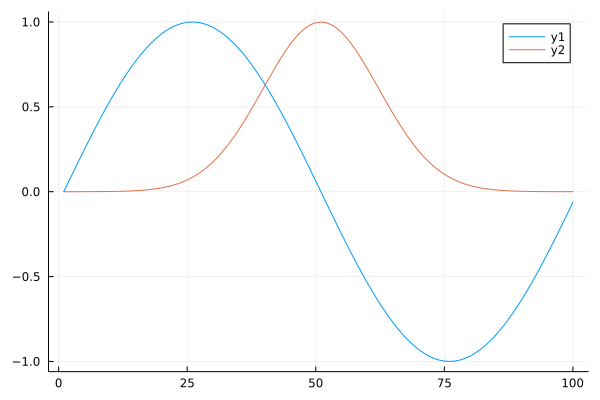

In [25]:
using Plots
nx = 100

u0 = sample_wave(nx)
plot(u0)

w0 = sample_gaussian(nx)
plot!(w0)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/sinewave_c1.2.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/sinewave_c1.2.gif")
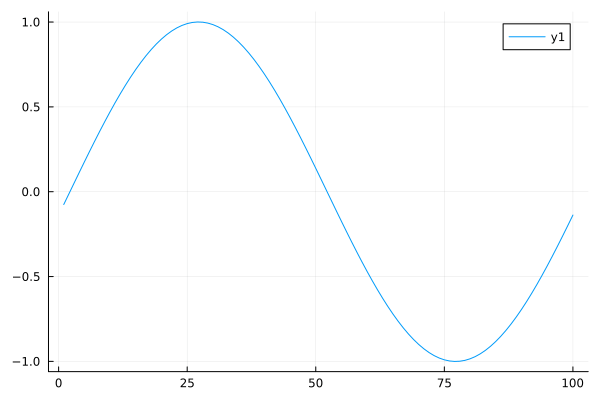

In [34]:
u0 = sample_wave(nx)
c = 1.2
# plot(u0)

gif_sinewave = @animate for i in 1:200
    global u0,c
    u0 = FTBS_step(nx,c,u0)
    plot(u0)
end

gif(gif_sinewave, "sinewave_c$c.gif", fps = 20)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/gaussian_c1.2.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/gaussian_c1.2.gif")
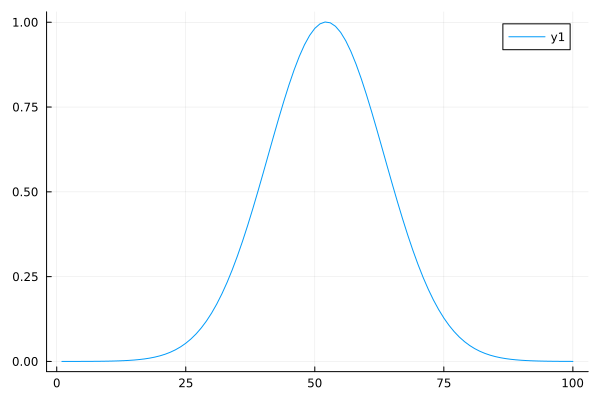

In [33]:
u0 = sample_gaussian(nx)
c = 1.2
# plot(u0)

gif_sinewave = @animate for i in 1:200
    global u0,c
    u0 = FTBS_step(nx,c,u0)
    plot(u0)
end

gif(gif_sinewave, "gaussian_c$c.gif", fps = 20)

### For FTBS

$c<1.0$ Stable, with amplitude decaying.
$c=1.0$ Exact cancel of error, emulating propagation.
$c>1.0$ Numerical unstable.

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/sinewave_c1.0 FTCS.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/sinewave_c1.0 FTCS.gif")
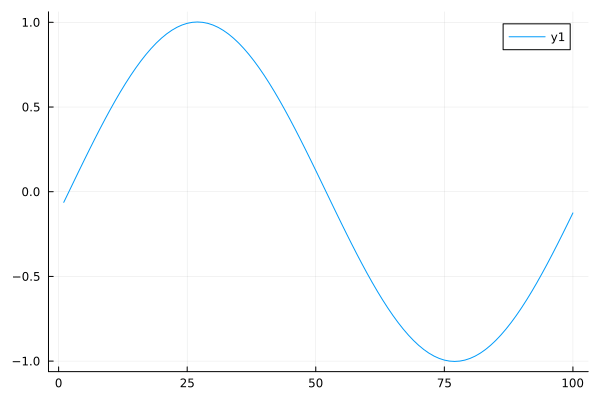

In [39]:
u0 = sample_wave(nx)
c = 1.0
# plot(u0)

gif_sinewave = @animate for i in 1:200
    global u0,c
    u0 = FTCS_step(nx,c,u0)
    plot(u0)
end

gif(gif_sinewave, "sinewave_c$c FTCS.gif", fps = 20)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/gaussian_c1.0 FTCS.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/gaussian_c1.0 FTCS.gif")
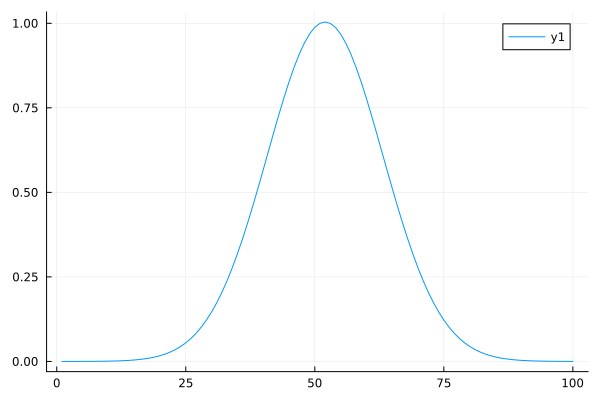

In [40]:
u0 = sample_gaussian(nx)
c = 1.0
# plot(u0)

gif_sinewave = @animate for i in 1:200
    global u0,c
    u0 = FTCS_step(nx,c,u0)
    plot(u0)
end

gif(gif_sinewave, "gaussian_c$c FTCS.gif", fps = 20)

### For FTCS

Slways blow up no matter $c$ value.

In [53]:
function iterate_for1period_FTBS(nx,c,u,periodic = true)
    un = u
    n_1period = floor(nx/c)
    for i in 1:n_1period
        un = FTBS_step(nx,c,un,periodic)
    end
    return un
end

function iterate_for1period_FTCS(nx,c,u,periodic = true)
    un = u
    n_1period = Int(nx/c)
    for i in 1:n_1period
        un = FTCS_step(nx,c,un,periodic)
    end
    return un
end

iterate_for1period_FTCS (generic function with 2 methods)

In [56]:
u0 = sample_wave(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_FTBS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("sinewave_clist_FTBS.png")

plot();

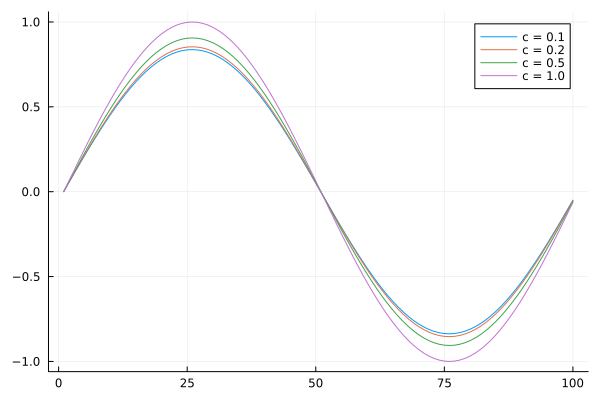

In [57]:
u0 = sample_gaussian(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_FTBS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("gaussian_clist_FTBS.png")

plot();

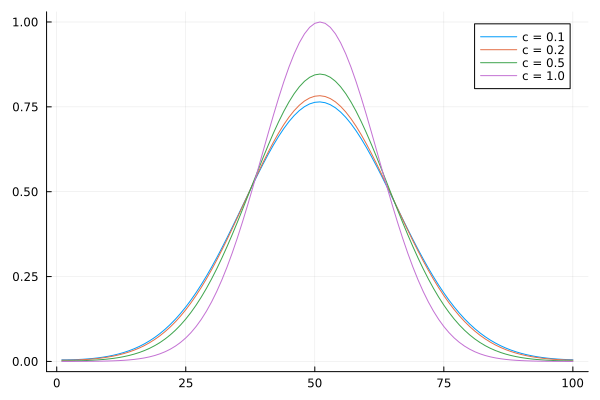

In [58]:
u0 = sample_wave(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_FTCS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("sinewave_clist_FTCS.png")

plot();

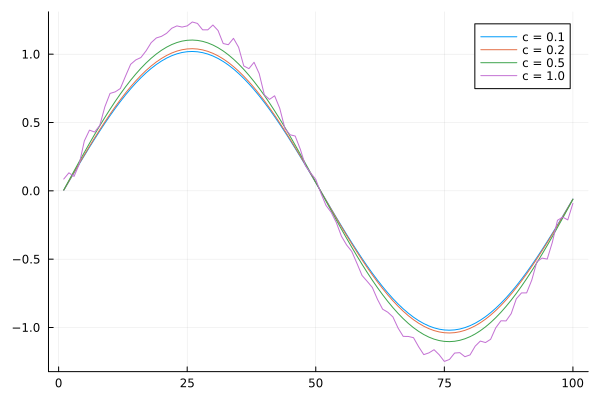

In [64]:
u0 = sample_gaussian(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_FTCS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("gaussian_clist_FTCS.png")

plot();

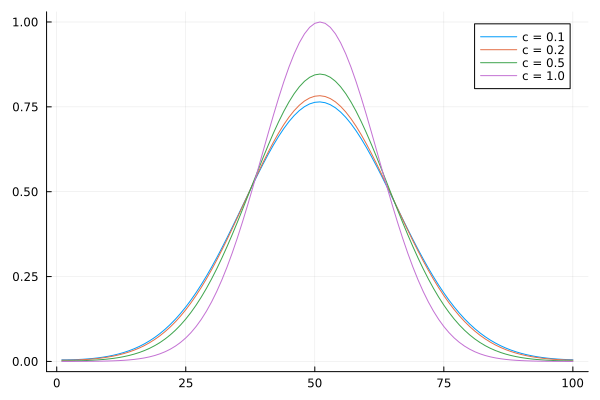

## CTCS Scheme

In CTCS, the iteration is:
$$
\phi^{n+1}_j=\phi_j^{n-1}-c(\phi_{j+1}^n-\phi_{j-1}^n)
$$

In [71]:
function CTCS_step(nx,c,u_1,u_2,periodic = true)
    un = zeros(nx)

    if periodic
        un[1] = u_1[1] - c*(u_2[2]-u_2[nx])
        un[nx] = u_1[nx] - c*(u_2[1]-u_2[nx-1])
    else
        un[1] = u_1[1]
        un[nx] = u_1[nx]
    end

    for i in 2:nx-1
        un[i] = u_1[i] - c*(u_2[i+1]-u_2[i-1])
    end

    return u_2, un
end

function CTCS_firststep(nx,c,u,periodic = true)
    u_1 = u
    u_2 = FTCS_step(nx,c,u,periodic)
    return u_1, u_2
end

CTCS_firststep (generic function with 2 methods)

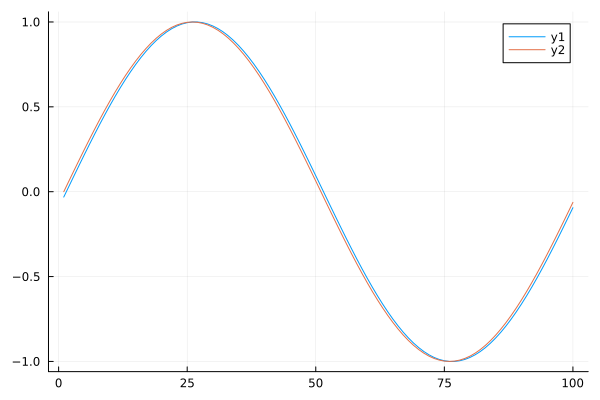

In [72]:
u0 = sample_wave(nx)
c = 0.5

u_1, u_2 = CTCS_firststep(nx,c,u0)
plot(u_2)
plot!(u_1)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/sinewave_c1.2 CTCS.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/sinewave_c1.2 CTCS.gif")
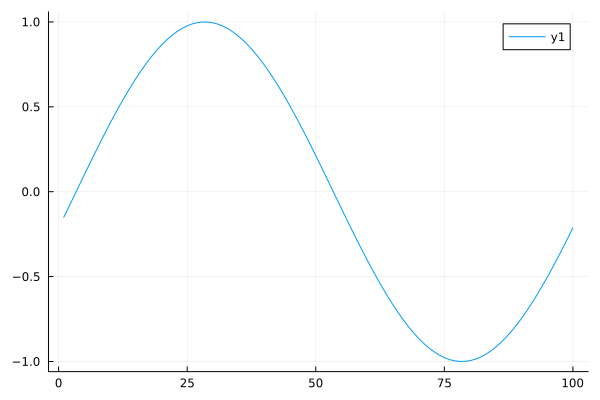

In [82]:
u0 = sample_wave(nx)
c = 1.2

u_1, u_2 = CTCS_firststep(nx,c,u0)

gif_sinewave = @animate for i in 1:200
    global u_1,u_2,c
    u_1, u_2 = CTCS_step(nx,c,u_1,u_2)
    plot(u_2)
end

gif(gif_sinewave, "sinewave_c$c CTCS.gif", fps = 20)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/gaussian_c1.2 CTCS.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/gaussian_c1.2 CTCS.gif")
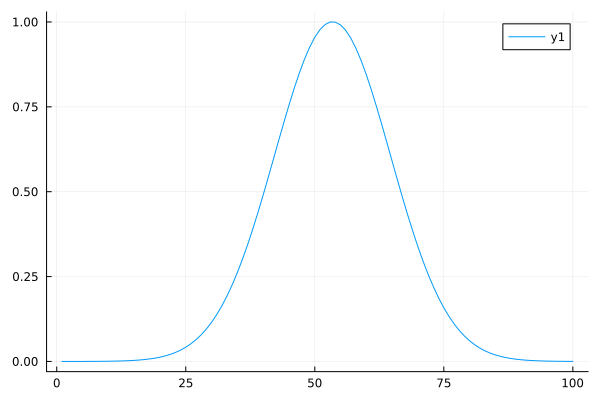

In [85]:
u0 = sample_gaussian(nx)
c = 1.2

u_1, u_2 = CTCS_firststep(nx,c,u0)

gif_sinewave = @animate for i in 1:200
    global u_1,u_2,c
    u_1, u_2 = CTCS_step(nx,c,u_1,u_2)
    plot(u_2)
end

gif(gif_sinewave, "gaussian_c$c CTCS.gif", fps = 20)

In [88]:
function sample_packetgaussian(nx)
    x = 0:2*pi/nx:2*pi
    u = exp.(-20*(x.-pi).^2)
    return u
end

function sample_twofreq(nx)
    x = 0:2*pi/nx:2*pi
    u = sin.(x) + sin.(2*x)
    return u
end

sample_twofreq (generic function with 1 method)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/packet_c0.5 CTCS.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/packet_c0.5 CTCS.gif")
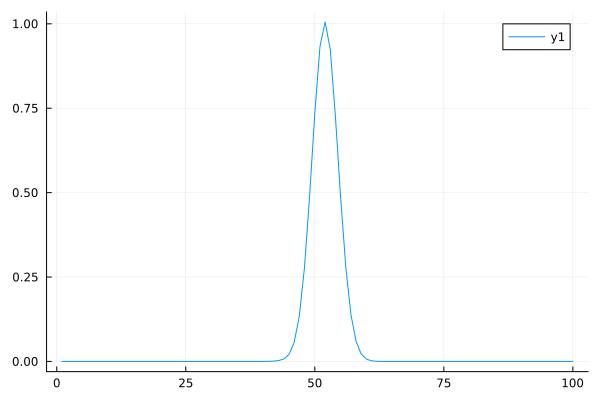

In [87]:
u0 = sample_packetgaussian(nx)
c = 0.5

u_1, u_2 = CTCS_firststep(nx,c,u0)

gif_sinewave = @animate for i in 1:200
    global u_1,u_2,c
    u_1, u_2 = CTCS_step(nx,c,u_1,u_2)
    plot(u_2)
end

gif(gif_sinewave, "packet_c$c CTCS.gif", fps = 20)

[ Info: Saved animation to /home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/twofreq_c0.5 CTCS.gif


Plots.AnimatedGif("/home/zgd/projects/GithubRepos/myExploration/computationalPhysicsCourses/ex07/twofreq_c0.5 CTCS.gif")
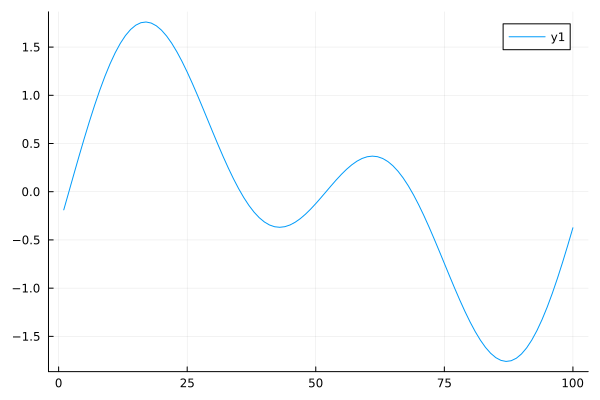

In [89]:
u0 = sample_twofreq(nx)
c = 0.5

u_1, u_2 = CTCS_firststep(nx,c,u0)

gif_sinewave = @animate for i in 1:200
    global u_1,u_2,c
    u_1, u_2 = CTCS_step(nx,c,u_1,u_2)
    plot(u_2)
end

gif(gif_sinewave, "twofreq_c$c CTCS.gif", fps = 20)

In [90]:
function iterate_for1period_CTCS(nx,c,u,periodic = true)
    u_1, u_2 = CTCS_firststep(nx,c,u,periodic)
    n_1period = Int(nx/c)
    for i in 1:n_1period
        u_1, u_2 = CTCS_step(nx,c,u_1,u_2,periodic)
    end
    return u_2
end

iterate_for1period_CTCS (generic function with 2 methods)

In [93]:
u0 = sample_packetgaussian(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_CTCS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("packet_clist_CTCS.png")
plot();

In [94]:
u0 = sample_gaussian(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_CTCS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("gaussian_clist_CTCS.png")
plot();

In [95]:
u0 = sample_twofreq(nx)
c_list = [0.1,0.2,0.5,1.0]

for c in c_list
    u1 = iterate_for1period_CTCS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("twofreq_clist_CTCS.png")
plot();

In [96]:
function sample_delta(nx)
    x = 0:2*pi/nx:2*pi
    u = exp.(-100*(x.-pi).^2)
    return u
end

sample_delta (generic function with 1 method)

In [98]:
u0 = sample_delta(nx)
c_list = [0.1,0.2,0.5,1.0]

plot(u0,label="original")
for c in c_list
    u1 = iterate_for1period_CTCS(nx,c,u0)
    plot!(u1,label="c = $c")
end

savefig("delta_clist_CTCS.png")
plot();